In [5]:
from mmdet.apis import DetInferencer

# Choose to use a config
model_name = './work_dirs/rtm-l_det_basic/rtm-l_det_basic.py'
# Setup a checkpoint file to load
checkpoint = './work_dirs/rtm-l_det_basic/epoch_40.pth'

# Set the device to be used for evaluation
device = 'cuda:0'

# Initialize the DetInferencer
inferencer = DetInferencer(model_name, checkpoint, device)

# Use the detector to do inference
img = '../sample/train_scale1_h640_w640_oh0.5_ow0.5_min1_segs/maxar_001_0_6400_640_7040.jpg'
result = inferencer(img, out_dir='./output/003/')

Loads checkpoint by local backend from path: ./work_dirs/rtm-l_det_basic/epoch_40.pth


/opt/conda/lib/python3.7/site-packages/rich/live.py:231: UserWarning: install "ipywidgets" for Jupyter support
  warnings.warn('install "ipywidgets" for Jupyter support')

In [6]:
# Show the structure of result dict
from rich.pretty import pprint
pprint(result, max_length=4)

{
│   'predictions': [
│   │   {
│   │   │   'bboxes': [
│   │   │   │   [566.0130615234375, 569.0344848632812, 577.1096801757812, 585.2388916015625],
│   │   │   │   [541.0987548828125, 571.5909423828125, 552.1749877929688, 589.4445190429688],
│   │   │   │   [156.96763610839844, 292.3426208496094, 166.60226440429688, 312.1289367675781],
│   │   │   │   [605.4901733398438, 166.8843536376953, 611.8817138671875, 180.5867156982422],
│   │   │   │   ... +496
│   │   │   ],
│   │   │   'labels': [0, 0, 0, 0, ... +496],
│   │   │   'scores': [0.8861374855041504, 0.7544191479682922, 0.7300793528556824, 0.6662262678146362, ... +496]
│   │   }
│   ],
│   'visualization': [
│   │   array([[[  8,  11,   0],
│   │   [ 14,  17,   0],
│   │   [ 21,  24,   5],
│   │   ...,
│   │   [ 33,  34,  18],
│   │   [ 36,  37,  21],
│   │   [ 39,  40,  24]],
│      
│      [[ 11,  14,   0],
│   │   [ 19,  22,   3],
│   │   [ 29,  32,  13],
│   │   ...,
│   │   [ 34,  35,  19],
│   │   [ 41,  42,  26],
│   │   [ 44,  45,  29]],
│      
│      [[ 21,  24,   5],
│   │   [ 27,  30,  11],
│   │   [ 32,  35,  16],
│   │   ...,
│   │   [ 39,  40,  24],
│   │   [ 50,  51,  35],
│   │   [ 54,  55,  39]],
│      
│      ...,
│      
│      [[ 39,  36,  17],
│   │   [ 41,  40,  20],
│   │   [ 45,  42,  23],
│   │   ...,
│   │   [ 16,  10,   0],
│   │   [ 17,  10,   0],
│   │   [ 17,  10,   2]],
│      
│      [[ 59,  58,  38],
│   │   [ 60,  62,  41],
│   │   [ 65,  64,  44],
│   │   ...,
│   │   [ 17,  11,   0],
│   │   [ 17,  13,   2],
│   │   [ 18,  14,   3]],
│      
│      [[ 99, 101,  80],
│   │   [102, 104,  83],
│   │   [103, 105,  84],
│   │   ...,
│   │   [ 18,  12,   0],
│   │   [ 18,  14,   3],
│   │   [ 19,  15,   4]]], dtype=uint8)
│   ]
}

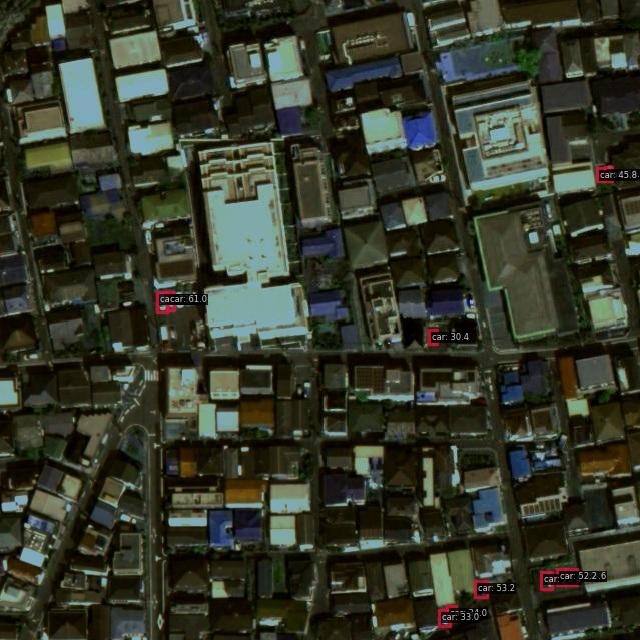

In [7]:
# Show the output image
from PIL import Image
Image.open('./output/003/vis/maxar_001_0_6400_640_7040.jpg')

0 ../sample/train_scale1_h640_w640_oh0.5_ow0.5_min1_segs/maxar_002_2240_4480_2880_5120.jpg


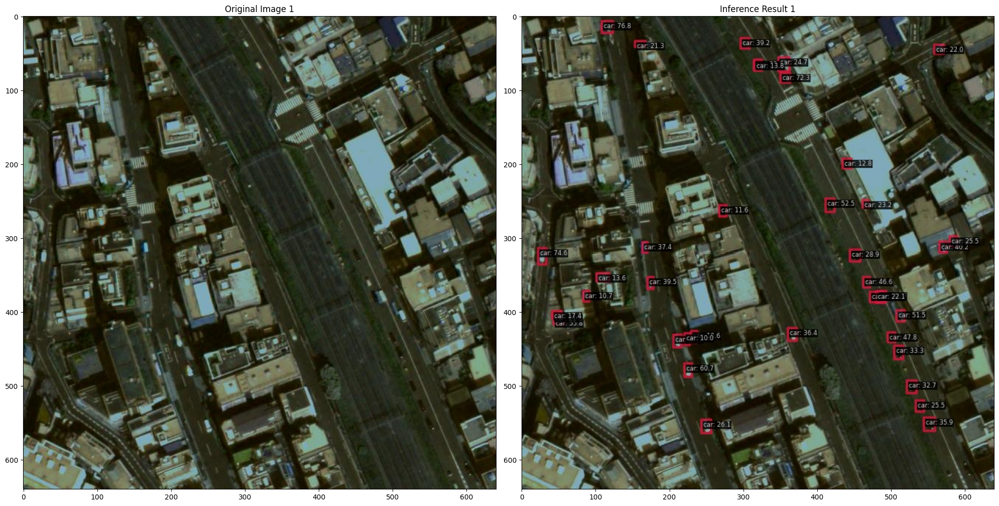

1 ../sample/train_scale1_h640_w640_oh0.5_ow0.5_min1_segs/maxar_002_3840_1600_4480_2240.jpg


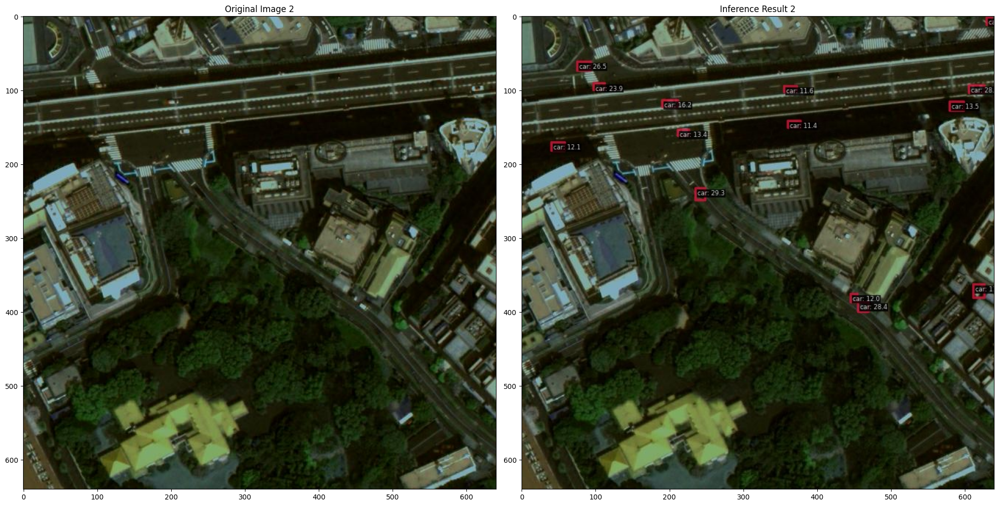

2 ../sample/train_scale1_h640_w640_oh0.5_ow0.5_min1_segs/maxar_001_960_8000_1600_8640.jpg


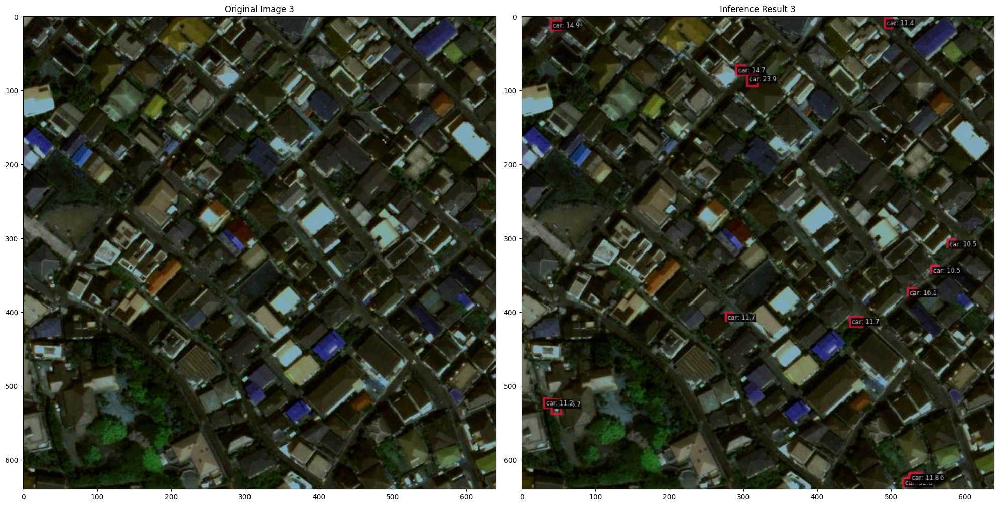

3 ../sample/train_scale1_h640_w640_oh0.5_ow0.5_min1_segs/maxar_001_320_8464_960_9104.jpg


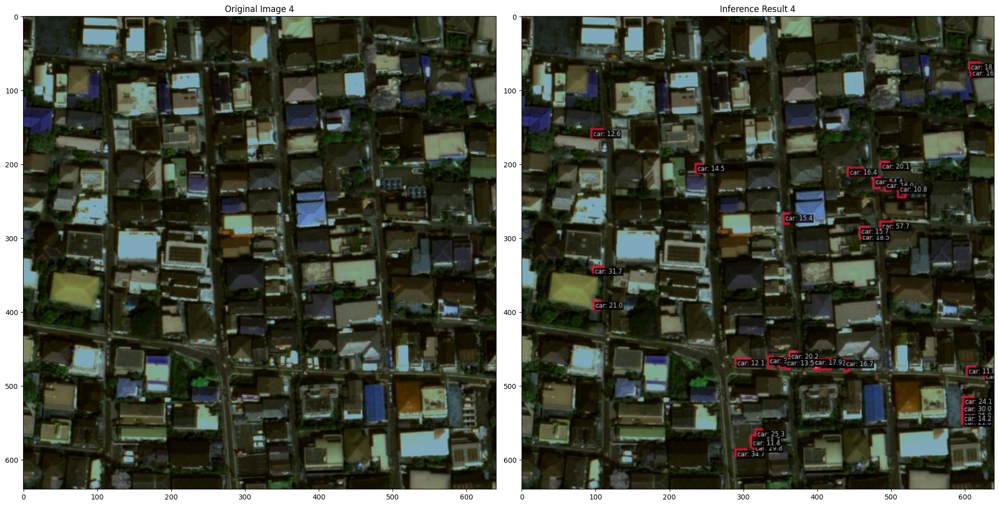

4 ../sample/train_scale1_h640_w640_oh0.5_ow0.5_min1_segs/maxar_001_1600_320_2240_960.jpg


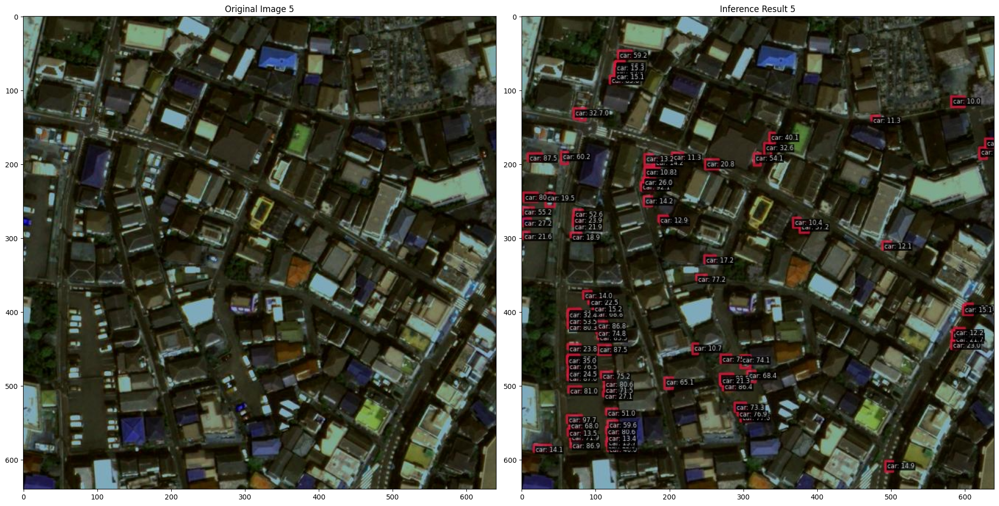

5 ../sample/train_scale1_h640_w640_oh0.5_ow0.5_min1_segs/maxar_002_960_3840_1600_4480.jpg


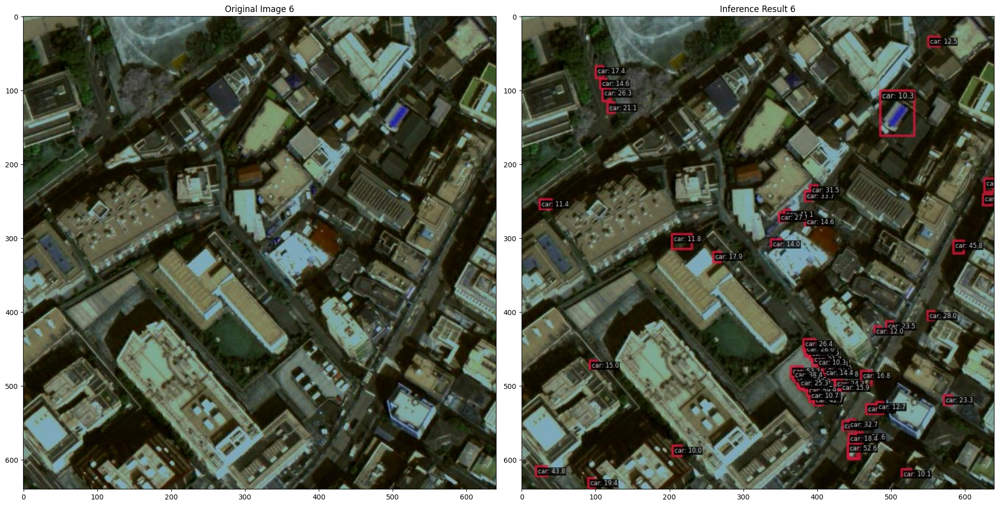

6 ../sample/train_scale1_h640_w640_oh0.5_ow0.5_min1_segs/maxar_002_2560_0_3200_640.jpg


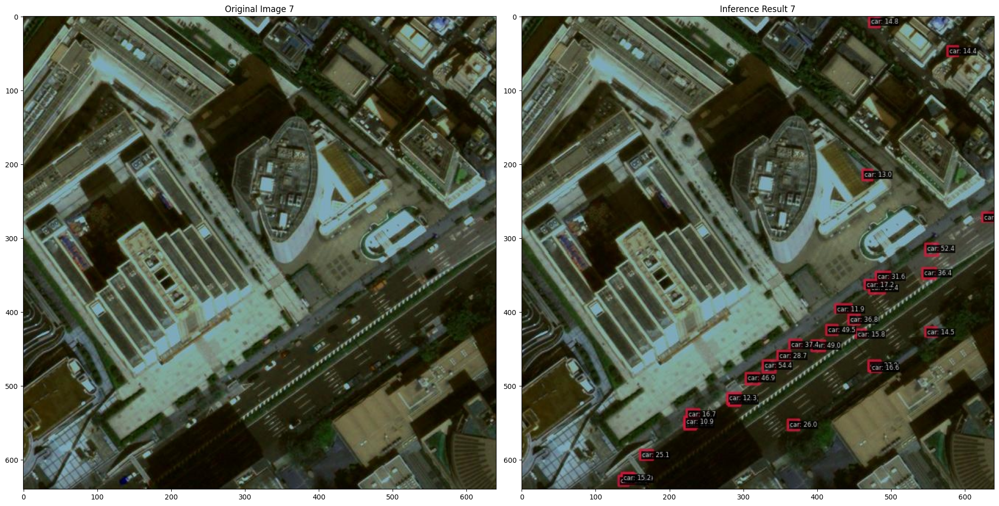

7 ../sample/train_scale1_h640_w640_oh0.5_ow0.5_min1_segs/maxar_001_960_5440_1600_6080.jpg


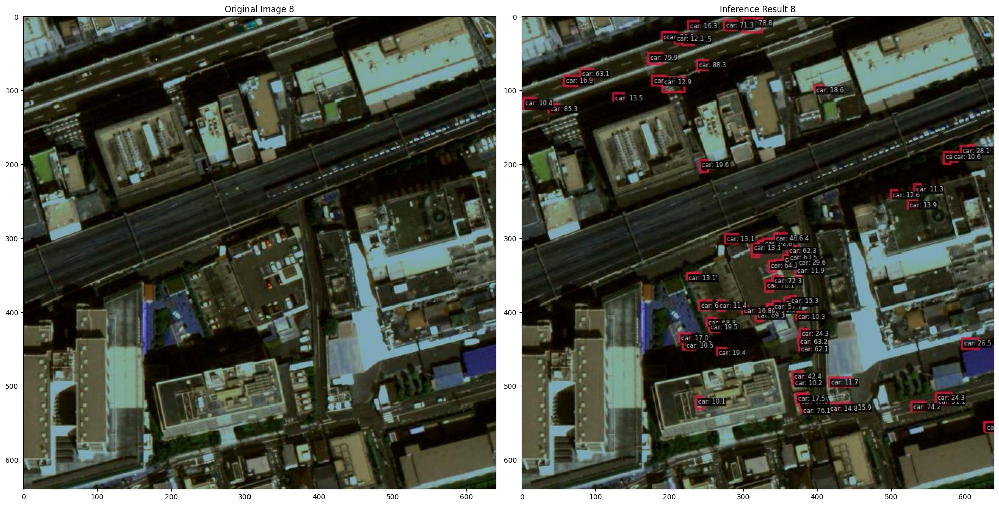

8 ../sample/train_scale1_h640_w640_oh0.5_ow0.5_min1_segs/maxar_002_3200_4480_3840_5120.jpg


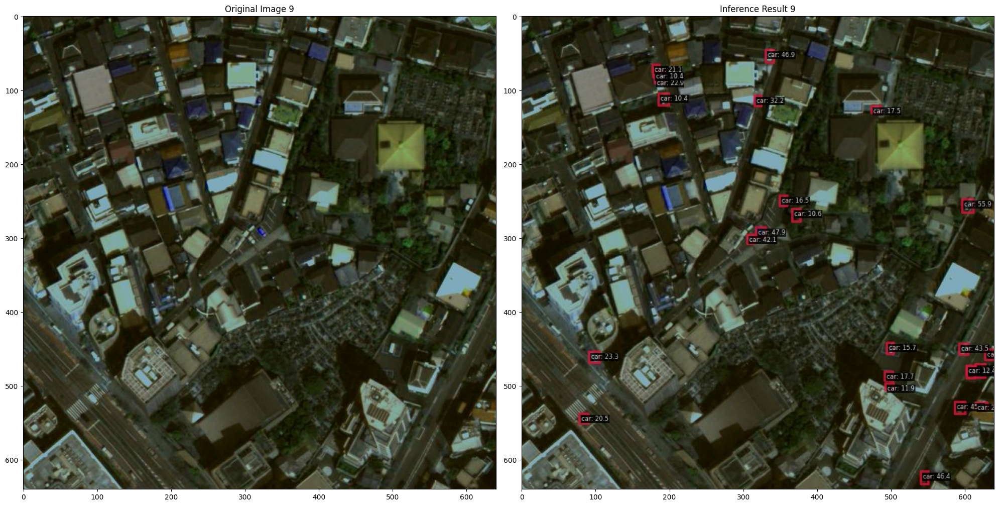

9 ../sample/train_scale1_h640_w640_oh0.5_ow0.5_min1_segs/maxar_002_4160_0_4800_640.jpg


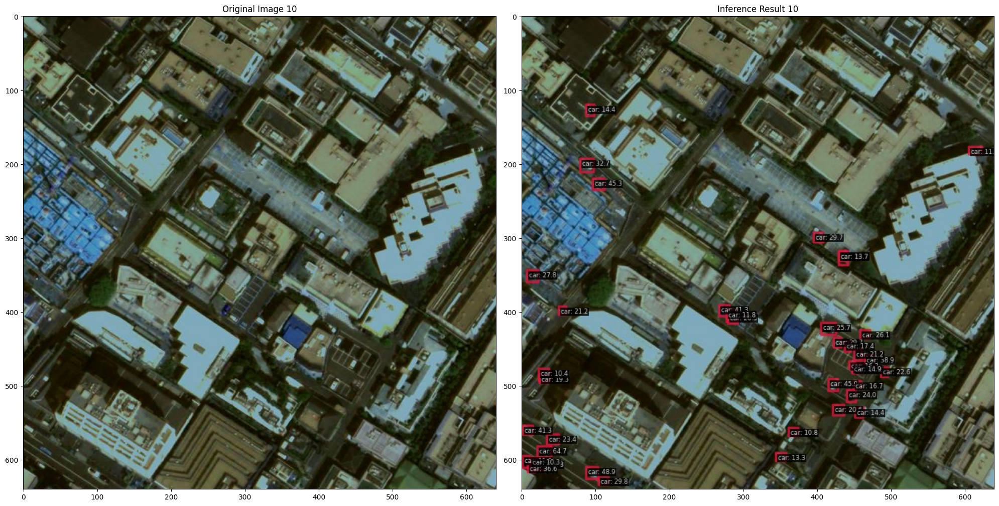

10 ../sample/train_scale1_h640_w640_oh0.5_ow0.5_min1_segs/maxar_001_1280_7680_1920_8320.jpg


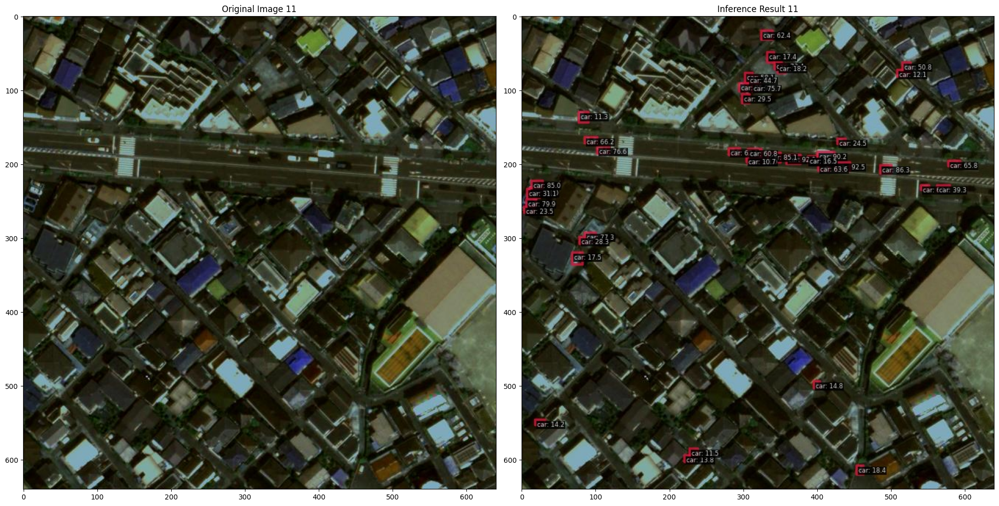

11 ../sample/train_scale1_h640_w640_oh0.5_ow0.5_min1_segs/maxar_002_2240_5565_2880_6205.jpg


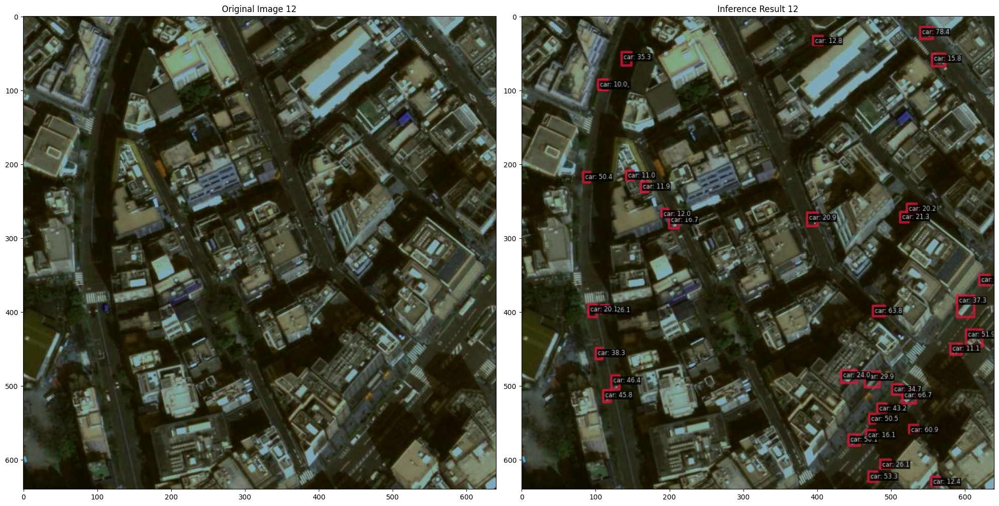

In [13]:
from glob import glob
import matplotlib.pyplot as plt
import os

NUM_SAMPLE = 12
PATHS = glob('../sample/train_scale1_h640_w640_oh0.5_ow0.5_min1_segs/*.jpg')[4:4+NUM_SAMPLE]

for i, PATH in enumerate(PATHS):
    
    print(i, PATH)
    result = inferencer(PATH, out_dir='./output/003/', pred_score_thr=0.1, show=True,);
    PATH_INF = f'output/003/vis/{os.path.basename(PATH)}'
    
    plt.figure(figsize=(20, 10), dpi=100, facecolor='w', edgecolor='k')
    plt.subplot(1, 2, 1)
    plt.title(f'Original Image {i+1}')
    plt.imshow(Image.open(PATH))
    plt.subplot(1, 2, 2)
    plt.title(f'Inference Result {i+1}')
    plt.imshow(Image.open(PATH_INF))
    plt.tight_layout()
    plt.savefig(f'output/003/mmdet_inference_pair_{os.path.basename(PATH)}', dpi=100)
    plt.show();
    
    plt.clf()
    plt.close() 